# Lab 6 Report: 
## Audio Filtering with Gated RNNs

### Name: Andrew Tettamanti

In [52]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import torch
import seaborn as sns
import IPython

from scipy.io.wavfile import write

In [53]:
from IPython.display import Image # For displaying images in colab jupyter cell

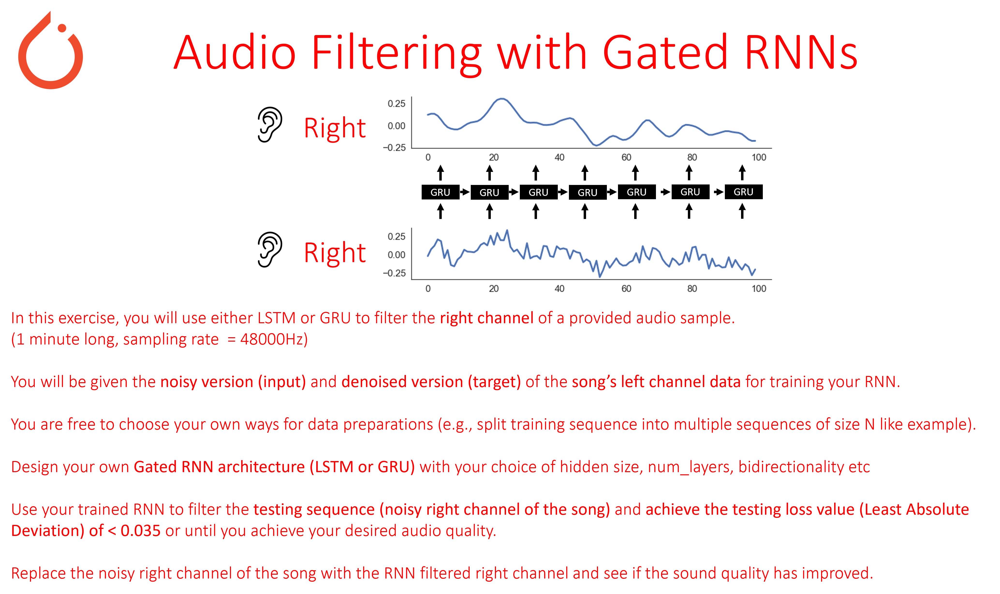

In [54]:
Image('lab6_exercise.png', width = 1000)

In [55]:
sns.set(style = 'white', font_scale = 1.5)

## Prepare Data

In [56]:
# Listen to audio with noisy right channel
# Our goal is to use RNN to denoise the right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

import IPython
IPython.display.Audio("TSR_noisy.wav")

In [57]:
train_input_seqs = np.load('audio_train_inputs.npy') # Noisy left channel audio (training inputs to your RNN)
train_output_seqs = np.load('audio_train_targets.npy') # Ground truth left channel audio (training targets for your RNN)

test_input_seqs = np.load('audio_train_inputs.npy')
test_output_seqs = np.load('audio_train_targets.npy')


# Print the length of training features and targets
print(len(train_input_seqs), len(train_output_seqs))




2754000 2754000


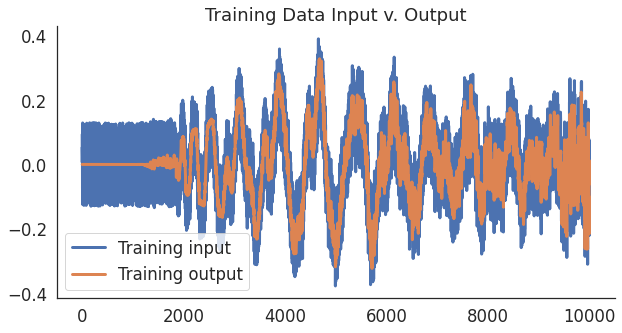

In [58]:
# view the training data
train_input_show = train_input_seqs[0:10000]
train_output_show = train_output_seqs[0:10000]


plt.figure(figsize = (10, 5))

plt.plot(train_input_show, label ='Training input', linewidth = 3)
plt.plot(train_output_show, label ='Training output', linewidth = 3)
plt.title('Training Data Input v. Output')
plt.legend()
sns.despine()


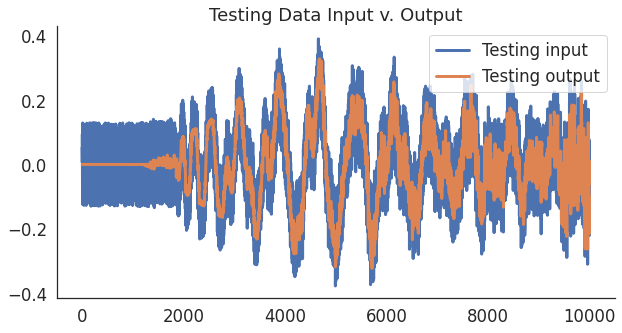

In [59]:
test_input_show = test_input_seqs[0:10000]
test_output_show = test_output_seqs[0:10000]

# view the testing data
plt.figure(figsize = (10, 5))

plt.plot(test_input_show, label ='Testing input', linewidth = 3)
plt.plot(test_output_show, label ='Testing output', linewidth = 3)
plt.title('Testing Data Input v. Output')
plt.legend()
sns.despine()

In [60]:
# Reshape train_input_seqs and train_output_seqs to 2D arrays
# Each row corresponds to a single training input/target sequence
# e.g., if your training sequence length = 100 -> train_input_seqs/output_seqs should have shape (27540, 100)
# Feel free to choose your own training sequence length

# reshape into 2D arrays test and train
train_input_seqs = np.reshape(train_input_seqs,(27540,100))
train_output_seqs = np.reshape(train_output_seqs,(27540,100))

test_input_seqs = np.reshape(test_input_seqs,(27540,100))
test_output_seqs = np.reshape(test_output_seqs,(27540,100))

In [61]:
# Reshape train_input_seqs and output_seqs again to conform to PyTorch (sample size (N), sequence length, # of features)

# create a sequence lenth of 100
train_input_seqs = np.reshape(train_input_seqs,(27540,100,1))
train_output_seqs = np.reshape(train_output_seqs,(27540,100,1))

test_input_seqs = np.reshape(test_input_seqs,(27540,100,1))
test_output_seqs = np.reshape(test_output_seqs,(27540,100,1))

#check shapes of train and test arrays
train_input_seqs.shape
train_output_seqs.shape

test_input_seqs.shape
test_input_seqs.shape

(27540, 100, 1)

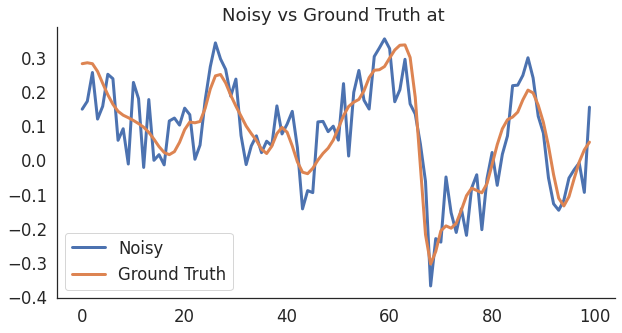

In [62]:
# let's plot one of the training input sequence/output target (10th sample)
# Feel free to plot a different sample
sequence = 10000
plt.figure(figsize = (10, 5))

plt.plot(train_input_seqs[sequence], label ='Noisy', linewidth = 3)
plt.plot(train_output_seqs[sequence], label ='Ground Truth', linewidth = 3)
plt.title('Noisy vs Ground Truth at '.format(sequence))
plt.legend()
sns.despine()

## Define Model

In [63]:
# The Denoiser_RNN cell will pass the input to the GRU RNN
# The Denoiser_RNN will then take the input sequences and feed then imto the decoder layer
# Then it will feed the decodeer through the activation layer

class Denoiser_RNN(torch.nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        
        super(Denoiser_RNN, self).__init__()
        
        # Using GRU cell with batch_first = True, i.e., we are using (sample_size, sequence_length, # of features) format
        # Bidirectional = True, both foward and backward context 
        self.gru = torch.nn.GRU(input_size=input_size, hidden_size=hidden_size, 
                                num_layers = num_layers, 
                                batch_first = True,
                                bidirectional = True,
                                dropout = 0.1)
        
        # Decoder layer to take in GRU hidden states and output a single number (i.e. denoised value at time t)
        self.decoder = torch.nn.Linear(hidden_size*2, output_size) 
        
        # Uses Tanh activation to squeeze the decoder output between -1 and 1
        # Note that our dataset consists of sinusoidal between -1 and 1
        self.output_activation = torch.nn.Tanh()
        
    def forward(self, input_seq, hidden_state):
        
        # Feed gru cell with input sequence and initial hidden state
        denoised_seq, hidden = self.gru(input_seq, hidden_state)
        
        # Feed the output of the GRU (denoised_seq) to decoder layer, followed by taking the Tanh activation
        denoised_seq = self.output_activation(self.decoder(denoised_seq))
        
        return denoised_seq

## Define Hyperparameters

In [64]:
# Define your model
denoiser_rnn = Denoiser_RNN(input_size = 1, hidden_size = 32, 
                            num_layers = 3, output_size = 1)

# Define lr and epochs
learning_rate = 0.0003   
epochs = 35

# Define mini-batch size
batchsize = 65

# Use L1Loss to minimize least absolute deviation + optimizer
loss_func = torch.nn.L1Loss()
optimizer = torch.optim.Adam(denoiser_rnn.parameters(), lr=learning_rate)

# Print out model specifics, add .cuda() if using GPU
denoiser_rnn.cuda()

Denoiser_RNN(
  (gru): GRU(1, 32, num_layers=3, batch_first=True, dropout=0.1, bidirectional=True)
  (decoder): Linear(in_features=64, out_features=1, bias=True)
  (output_activation): Tanh()
)

## Identify Tracked Values

In [65]:
# Empty list to keep track of training loss

train_loss_list = []

## Train Model

In [66]:
# Convert your training data into torch tensors
# use the cuda GPU
train_input_seqs = torch.from_numpy(train_input_seqs).float().cuda()
train_output_seqs = torch.from_numpy(train_output_seqs).float().cuda()



# Split your training data into mini-batches

train_batches_features = torch.split(train_input_seqs, batchsize)
train_batches_targets = torch.split(train_output_seqs, batchsize)

# Total number of mini-batches in the training set

batch_split_num = len(train_batches_features)

for epoch in range(epochs):
    
    for k in range(batch_split_num):

        # initialize the hidden states as None
        hidden_state = None
    
        # Feed in k-th mini-batch training features to GRU + hidden states to produce output
        denoised_seq = denoiser_rnn(train_batches_features[k], hidden_state)

        # zero_grad() to clear gradient buffer
        optimizer.zero_grad()
        
        # Compute loss between the GRU denoised sequence vs target training sequence
        loss = loss_func(denoised_seq, train_batches_targets[k])
        # Append loss
        train_loss_list.append(loss.item())
        
        # Backpropagation
        loss.backward()
        
        # Update weights/biases
        optimizer.step()

    # Print the averaged training loss (L1 Loss) throughout epoch        
    print("Averaged Training Loss for Epoch ", epoch,": ", np.mean(train_loss_list[-batch_split_num:]))

Averaged Training Loss for Epoch  0 :  0.06025036268006518
Averaged Training Loss for Epoch  1 :  0.045672467795534515
Averaged Training Loss for Epoch  2 :  0.038250854572738115
Averaged Training Loss for Epoch  3 :  0.03619825923024624
Averaged Training Loss for Epoch  4 :  0.0354872889386244
Averaged Training Loss for Epoch  5 :  0.035079417284578085
Averaged Training Loss for Epoch  6 :  0.03475743432019679
Averaged Training Loss for Epoch  7 :  0.03455063521879602
Averaged Training Loss for Epoch  8 :  0.03438097398886281
Averaged Training Loss for Epoch  9 :  0.03424094429784367
Averaged Training Loss for Epoch  10 :  0.0341171521675896
Averaged Training Loss for Epoch  11 :  0.034016022186304604
Averaged Training Loss for Epoch  12 :  0.03388307157482179
Averaged Training Loss for Epoch  13 :  0.033744326915662246
Averaged Training Loss for Epoch  14 :  0.03361223929754968
Averaged Training Loss for Epoch  15 :  0.03349435044768846
Averaged Training Loss for Epoch  16 :  0.03331

## Visualize & Evaluate Model

### Visualizing Training Loss

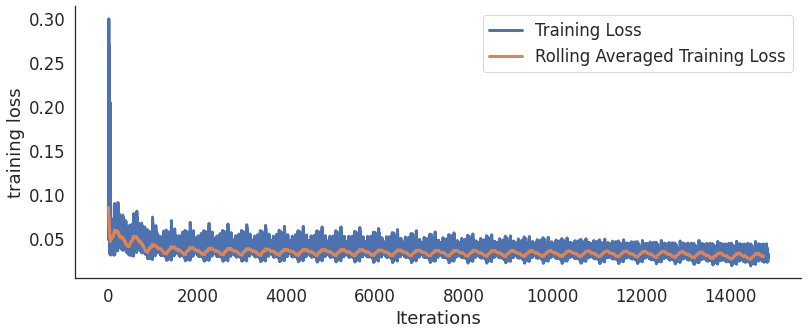

In [67]:
# Plot your training loss throughout the training 

plt.figure(figsize = (13, 5))

plt.plot(train_loss_list, linewidth = 3, label = 'Training Loss')
plt.plot(np.convolve(train_loss_list, np.ones(100), 'valid') / 100, 
         linewidth = 3, label = 'Rolling Averaged Training Loss')

plt.ylabel("training loss")
plt.xlabel("Iterations")
plt.legend()
sns.despine()

### Computing Testing Loss

In [68]:
# Load test features (Noisy right channel) and test targets for computing the test loss

test_input_seqs = np.load('audio_test_inputs.npy') # Noisy right channel audio (to be used as inputs to your trained RNN)
test_output_seqs = np.load('audio_test_targets.npy') # Groundtruth right channel audio (to compute the test loss)

In [69]:
# Test features/targets have same dimension as training feature/targets

print(len(test_input_seqs), len(test_output_seqs))

2754000 2754000


In [70]:
# Convert your test_input_seqs and output_seqs into torch tensors
test_input_seqs = torch.from_numpy(test_input_seqs).cuda()
test_output_seqs = torch.from_numpy(test_output_seqs).cuda()

# Reshape your test_input_seqs and output_seqs to 2D arrays as you did with train_input_seqs and output_seqs

test_input_seqs = torch.reshape(test_input_seqs,(27540,100))
test_output_seqs = torch.reshape(test_output_seqs,(27540,100))

# Reshape the test_input_seqs and output_seqs again to conform to (sample size (N), sequence length, # of features)
test_input_seqs = torch.reshape(test_input_seqs,(27540,100,1))
test_output_seqs = torch.reshape(test_output_seqs,(27540,100,1))

In [71]:
# Each noisy test input sequence is fed into your trained RNN to produce denoised outputs
# We need to take mini-batch approach since our test_features is too big to feed it all in once (i.e. not enough memory)

# Split the test_features and targets to mini-batches
test_batches_features = torch.split(test_input_seqs, batchsize)
test_batches_targets = torch.split(test_output_seqs, batchsize)

batch_split_num_test = len(test_batches_features)

# Empty lists to keep track of RNN denoised test sequences and test losses
test_prediction = []
test_losses = []

# Turn on no_grad() since we aren't performing backprop during this process
with torch.no_grad():
    
    for k in range(batch_split_num_test):
        
        # Feed in k-th test mini-batch to trained RNN
        test_pred = denoiser_rnn(test_batches_features[k], None)
        # Compre the test_pred with test target sequence to compute testing loss
        test_loss = loss_func(test_pred, test_batches_targets[k]).cpu()
        
        # Use torch.squeeze() to make test_pred to shape (batchsize, seq_len) and convert it to numpy array
        test_pred_numpy = torch.squeeze(test_pred).cpu().numpy()
        
        # Append both test_pred_numpy and test_loss 
        test_prediction.append(test_pred_numpy)
        test_losses.append(test_loss.item())
        
# Final testing loss is the average of all the test_losses from mini-batches        
print("Testing Loss (Least Absolute Deviations): ", np.mean(test_losses))

Testing Loss (Least Absolute Deviations):  0.031332179842481635


### Creating a new audio with denoised right channel sequence

In [72]:
# test_prediction is a list of 2D arrays where each array has shape (batchsize, seq_len)
# Vertically stack all appended 2D arrays so that we have a single 2D array
test_prediction = np.vstack(test_prediction)

In [73]:
#show the test pridiction 
print(test_prediction[91])

[ 0.00209137 -0.00885043 -0.05003887 -0.08056831 -0.11401749 -0.1433365
 -0.16180752 -0.15060131 -0.11577591 -0.07147337 -0.04025275 -0.03392953
 -0.056179   -0.06887671 -0.07691966 -0.08654233 -0.08467212 -0.08217539
 -0.09129867 -0.08574186 -0.07444575 -0.05527869 -0.03454052 -0.00755404
  0.01082517  0.01744193  0.01239657 -0.01427072 -0.05687452 -0.07771256
 -0.08294667 -0.07870432 -0.06388281 -0.05657322 -0.0379053  -0.02030486
 -0.00923976 -0.0043268  -0.00370857 -0.00899272 -0.00842522 -0.00205181
  0.00849818  0.0203506   0.02824087  0.03164382  0.02052162  0.01260035
 -0.01009636 -0.02554063 -0.04151268 -0.05653741 -0.05365936 -0.03966269
 -0.0307814  -0.01016217  0.01002692  0.01582823  0.02037327  0.01799242
  0.00609469  0.00477629  0.00215196  0.01871681  0.03188953  0.04177997
  0.04970853  0.04384834  0.04120217  0.03937316  0.03349175  0.02284789
  0.02480126  0.03474729  0.04447035  0.06393589  0.07716361  0.07905148
  0.07618614  0.05978367  0.04556597  0.0354387   0.

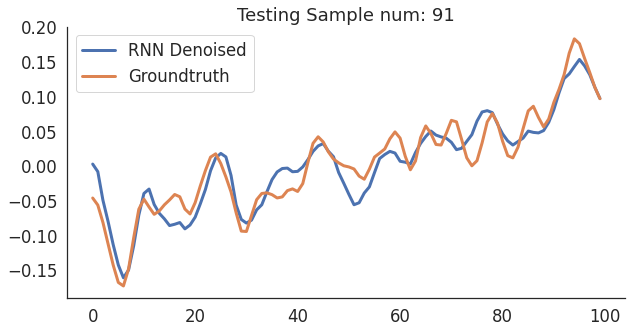

In [74]:
# We can visualize RNN denoised test sequence vs ground truth test sequence for particular sample
test_sample_num = 91
test_output_seqs =   test_output_seqs.cpu().numpy()

plt.figure(figsize = (10, 5))

plt.plot(test_prediction[test_sample_num], label='RNN Denoised', linewidth = 3)
plt.plot(test_output_seqs[test_sample_num], label='Groundtruth', linewidth = 3)
plt.legend()
plt.title("Testing Sample num: {}".format(test_sample_num))
sns.despine()

In [75]:
# Reshape the test_prediction to 1D array of size 2754000 so that we can use it as the right channel of the song

# Reshape the train_output_seqs (ground truth left channel of the song) to 1D array as well

train_output_seqs = train_output_seqs.cpu().numpy()
train_output_seqs = np.reshape(train_output_seqs,(2754000))

test_prediction =  np.reshape(test_prediction,(2754000))



In [76]:
# Construct an array 'fixed_audio' of size (2754000, 2) 
# where the first column (left channel) is 1D reshaped train_output_seqs (groundtruth left channel)
# And second column (right channel) is the 1D reshaped test_prediction (RNN denoised)

#stack use vstack and transpose to create the 2D array of fixed audio
fixed_audio = np.vstack((train_output_seqs,test_prediction)).T

In [77]:
#verify the shape
print(np.shape(fixed_audio))

(2754000, 2)


In [78]:
# Scale the fixed_audio so that it's in int16 form and write it into a new audio file

scaled = np.int16(fixed_audio/np.max(np.abs(fixed_audio)) * 32767)
write('TSR_fixed.wav', 48000, scaled)

In [79]:
# Listen to the new audio with denoised right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR_fixed.wav")

In [80]:
# Compare your denoised audio with ground truth audio for reference
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR.wav")